# Automated Car Detection in Aerial Imagery

## Overview
Analysis sought to reproduce encouraging results reported by Satellite Imagery Multiscale Rapid Detection with Windowed Networks (SIMRDWN) project which evaluated the performance of various object detection models - SSD, Faster R-CNN, and R-FCN - for automated detection of cars in complex urban environments: https://arxiv.org/pdf/1809.09978.pdf.

The SIMRDWN study utilised the Cars Overhead With Context (COWC) dataset for training and validation - comprising Earth Observation imagery captured at 15cm pixel resolution from six distinct locations: Toronto (Canada), Selwyn (New Zealand), Potsdam (Germany), Vaihingen (Germany), Columbus (United States) and Utah (United States): https://gdo152.llnl.gov/cowc/.

In a generalised sense, objective of this study examined feasibility of training deep learning models to identify multiple instances of small objects across wide area aerial / satellite imagery. Analysis focussed on evaluating performance of You Only Look Once, or YOLO model (version 3) - a family of end-to-end deep learning models designed for fast object detection, developed by Joseph Redmon, et al. and first described in the 2015 paper titled You Only Look Once: Unified, Real-Time Object Detection: https://arxiv.org/abs/1506.02640

Identifying small objects in large-scale remote sensing imagery using CNN-based models is a challenging problem -in terms of large image sizes, complex backgrounds - but also feature information associated with small objects tends to 'disappear' as it is processed through multiple convolution and pooling layers. YOLOv3 applies Feature Pyramid Network technique to improve detection of small objects where feature maps are extracted at three different scales and subsequently concatenated - fusing low-resolution, semantically strong features with high-resolution finer detail - see: https://pjreddie.com/media/files/papers/YOLOv3.pdf

The YOLOv3 implementation utilised for this study was keras-yolo3: Training and Detecting Objects with YOLO31 by Huynh Ngoc Anh or experiencor - see: https://github.com/experiencor/keras-yolo3

## Method

Code was developed to slice up COWC PNG images into 512x512 JPEG-encoded chunks with a small degree of overlap (10%) - car objects were defined as 3 m x 15cm resolution = 20 x 20 pixel bounding boxes centred on labelled pixel locations extracted from  corresponding annotation images - annotation information was written to XML file in PASCAL VOC format. For sake of simplicity (and reduce training times), only Toronto (train) and Potsdam (validation / test ) datasets were utilised during this analysis. Functionality is implemented within scripts located in src directory - see: https://github.com/chris010970/cowc/tree/master/src

Having generated image / annotation for train and test, keras-yolo3 readMe provides comprehensive instructions for configuring and training an instance of YOLOv3 model - see: https://github.com/experiencor/keras-yolo3. Analysis utilised hyperparameter settings defined in default config.json file - see below:

    {
        "model" : {
            "min_input_size":       352,
            "max_input_size":       448,
            "anchors":              [10,13,  16,30,  33,23,  30,61,  62,45,  59,119,  116,90,  156,198,  373,326],
            "labels":               ["car"]
        },

    "train": {
        "train_image_folder":   "/path/to/train/images/",
        "train_annot_folder":   "/path/to/train/annotations/",
        "cache_name":           "cowc_train.pkl",

        "train_times":          10,             
        "pretrained_weights":   "",             
        "batch_size":           4,             
        "learning_rate":        1e-4,           
        "nb_epochs":            50,             
        "warmup_epochs":        3,              
        "ignore_thresh":        0.5,
		"gpus":                 "0",
		
		"grid_scales":          [1,1,1],
        "obj_scale":            5,
        "noobj_scale":          1,
        "xywh_scale":           1,
        "class_scale":          1,

        "tensorboard_dir":      "logs",
        "saved_weights_name":   "cowc.h5",
        "debug":                true
    },

    "valid": {
        "valid_image_folder":   "/path/to/valid/images/",
        "valid_annot_folder":   "/path/to/valid/annotations/",
        "cache_name":           "cowc_valid.pkl",
        "valid_times":          1
    }
}



## Results

In [1]:
import os

# authentication key
os.environ["GOOGLE_APPLICATION_CREDENTIALS"]='C:/Users/Chris.Williams/.gcs/arkham-255409-c59a52d8653f.json'

In [2]:
from google.cloud import storage
from io import BytesIO

# download pretrained model from google cloud
client = storage.Client()
bucket = client.get_bucket('eo-ald-update')

# construct remote path
repo = 'cowc'
filenames = [ 'models/yolo3-default.zip', 'data/test.zip' ]

# check files exist
for f in filenames:

    pathname = os.path.join( os.getcwd(), f )
    if not os.path.exists( pathname ):
                
        # make sub-directory if required
        if not os.path.exists ( os.path.dirname( pathname ) ):
            os.makedirs( os.path.dirname( pathname ) )

        # download blob
        remote_url = '{}/{}'.format( repo, f )

        blob = storage.blob.Blob( remote_url, bucket)
        with open( pathname, 'w+b' ) as z:
            blob.download_to_file( z )


In [3]:
from zipfile import ZipFile

# extract downloaded zip files 
for f in filenames:
    pathname = os.path.join( os.getcwd(), f )
#    with ZipFile( pathname, 'r') as zipObj:
       # extract contents to current directory
#       zipObj.extractall( os.path.dirname( pathname ) )

In [4]:
from projects.yolo3.voc import parse_voc_annotation

# for each subset
annotations = { 'train' : None, 'test': None }
for subset in [ 'train', 'test' ]:
    
    img_dir = os.path.join( os.getcwd(), 'data/{}/images/'.format( subset ) )
    ann_dir = os.path.join( os.getcwd(), 'data/{}/annotations/'.format( subset ) )
    
    # load annotations
    annotations[ subset ], seen_labels = parse_voc_annotation( ann_dir, img_dir, 'cowc.pkl', labels=['car'] )
    os.remove( 'cowc.pkl' )

<BarContainer object of 2 artists>

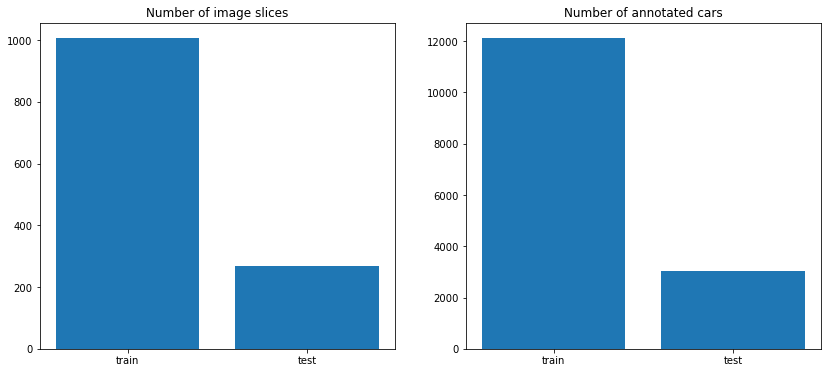

In [5]:
import matplotlib.pyplot as plt

# plot subset sample sizes
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# initialise counters
count = [0] * 2
for idx, subset in enumerate( [ 'train', 'test' ] ):

    # get number of annotated cars in train and test datasets
    for annotation in annotations[ subset ]:
        count[ idx ] += len( annotation[ 'object' ] )
        
# draw image counts as subplot
axes[ 0 ].set_title( 'Number of image slices' )
axes[ 0 ].bar( [ 'train', 'test' ], [ len( annotations[ 'train' ] ), len( annotations[ 'test' ] ) ] )

# draw annotated object counts as subplot
axes[ 1 ].set_title( 'Number of annotated cars' )
axes[ 1 ].bar( [ 'train', 'test' ], count )

In [6]:
import json

# get yolo3 configuration settings
config_pathname = os.path.join( os.getcwd(), 'models/yolo3-default/config.json' )
with open( config_pathname ) as buffer:    
    config = json.load( buffer )   

In [7]:
from keras.models import load_model

# load model weights from file
model_pathname = os.path.join( os.getcwd(), 'models/yolo3-default/cowc.h5' )
model = load_model( model_pathname )

Using TensorFlow backend.
c:\program files\python36\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
c:\program files\python36\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
c:\program files\python36\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
c:\program files\python36\lib\site-packages\tensorflow\python\framework\dtype

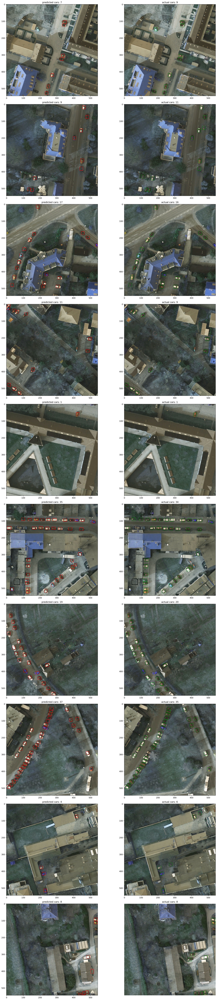

In [8]:
import cv2
import random
import matplotlib.patches as patches
from projects.yolo3.utils.utils import get_yolo_boxes

# create figure
max_rows = 10
plt.rcParams['figure.dpi'] = 200

fig, ax = plt.subplots( max_rows, 2, figsize=(18, 80) )
plt.axis('off')

# set parameters
net_h, net_w = 416, 416 # a multiple of 32, the smaller the faster
obj_thresh, nms_thresh = 0.5, 0.45

# shuffle annotations
random.shuffle( annotations[ 'test' ] )
for row, annotation in enumerate( annotations[ 'test' ] ): 
    
    # get image pathname
    path = os.path.join( os.getcwd(), 'data/test/images/' )
    pathname = os.path.join( path, annotation[ 'filename' ] )

    # get prediction for loaded image
    image = cv2.imread( pathname )
    height, width, channels = image.shape
    
    boxes = get_yolo_boxes( model, [image], net_h, net_w, config['model']['anchors'], obj_thresh, nms_thresh)[0]
    
    # draw predicted boxes onto image
    predicted_cars = 0
    for box in boxes:
        if box.classes[0] > obj_thresh:
            
            # ignore objects occluded by image edges
            if box.xmin > 0 and box.ymin > 0 and box.xmax < width - 1 and box.ymax < height - 1:

                # create and add rectangle patch
                rect = patches.Rectangle((box.xmin,box.ymin),(box.xmax-box.xmin),(box.ymax-box.ymin),linewidth=1,edgecolor='r',facecolor='none')
                ax[ row ][ 0 ].add_patch(rect)

                predicted_cars += 1
            
    # add image and subtitle
    ax[ row ][ 0 ].imshow(image)
    ax[ row ][ 0 ].set_title( 'predicted cars: {}'.format( predicted_cars ) )

    # draw predicted boxes onto image
    actual_cars = 0
    for obj in annotation[ 'object' ]:

            # create and add rectangle patch
            rect = patches.Rectangle((obj['xmin'],obj['ymin']),(obj['xmax']-obj['xmin']),(obj['ymax']-obj['ymin']),linewidth=1,edgecolor='g',facecolor='none')
            ax[ row ][ 1 ].add_patch(rect)

            actual_cars += 1
            
    # add image and subtitle
    ax[ row ][ 1 ].imshow(image)
    ax[ row ][ 1 ].set_title( 'actual cars: {}'.format( actual_cars ) )

    row += 1

    if row == max_rows:
        break

# tight layout with adjustment
fig.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()
